**Εργαστήριο Τεχνολογίας και Ανάλυσης Εικόνων και Βίντεο**

1η Εργαστηριακή Άσκηση


## **1. Θεωρητικό Μέρος**
a) The shape of the equivalent weighting function depends on the choice of parameter a. For a = 0.5, the function is triangular; for a =0.4 it is Gaussian-like, and for a = 0.3 it is broader than Gaussian. For a = 0.6 the function is trimodal.

b) If we assume that the pixel values of an image representation are statistically independent, then the minimum number of bits per pixel required to exactly encode the image is given by the entropy of the pixel value distribution. This optimum may be approached in practice through techniques such as variable length coding. Entropy is given by:

  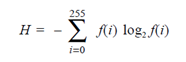

  The maximum entropy would be 8 in this case since the image is initially represented at 256 ray levels, and would be obtained when all gray levels were equally likely. The actual entropy estimate for "Lady" is slightly less than this, at 7.57.

c) Bin size at a given pyramid level reflects the sensitivity of the human observer to contrast errors within the spatial frequency bands represented at that level. Humans are fairly sensitive to contrast perturbations at low and medium spatial frequencies, but relatively insensitive to such perturbations at high spatial frequencies. This increased observer sensitivity along with the increased data variance noted above means that more quantization levels must be used at high pyramid levels than at low levels. Fortunately, these pixels contribute little to the overall bit rate for the image, due to their low sample density. The low-level (high-frequency) pixels, which are densely sampled, can be coarsely quantized.

d) The number of levels in the pyramid determines the amount of detail that is retained in the image. If the pyramid has many levels, then fine details in the image will be preserved, which can make quantization more difficult. Conversely, if the pyramid has few levels, then less detail will be retained, which can make quantization easier. Entropy can be substantially reduced by quantizing the pixel values in each level of the Laplacian pyramid. This introduces quantization errors, but through the proper choice of the number and distribution of quantization levels. the degradation may be made almost imperceptible to human observers.


# 2.Εργαστηριακό Μέρος

Α. Υλοποίηση Αλγορίθμου

In [ ]:
import urllib.request
import cv2
import scipy
import skimage
from skimage import data
from scipy.signal import convolve2d
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

Για το α)

In [ ]:
def GKernel(a):
  w = np.array([0.25 - a/2.0, 0.25, a, 0.25, 0.25 - a/2.0])                      # Μονοδιάστατος πυρήνας
  return w*w.reshape(-1,1)                                                       # Δισδιάστατος πυρήνας

Για το β)

In [ ]:
def GREDUCE(I,h):
  reduced_downsampled = None
  low_pass_image = cv2.filter2D(I,-1,h)                                          # Συγκλίνουμε την εικόνα με τον παραγόμενο πυρήνα
  reduced_downsampled = low_pass_image[::2,::2]                                  # Μειώνουμε τον ρυθμό δειγματοληψίας στο μισό
  return reduced_downsampled

Για το γ)

In [ ]:
def GPyramid(I,a,depth):
  pyramid = [I]
  kernel = GKernel(a)
  for i in range(0,depth-1):
    gaussian_image = GREDUCE(pyramid[i],kernel)                                  # Εφαρμόζουμε GREDUCE στην εικόνα το προηγούμενο επιπέδου για να πάρουμε lowpass εικόνα στο επόμενο επίπεδο
    pyramid.append(gaussian_image)
  return pyramid

Για το δ)

In [ ]:
def GEXPAND(I,h):
  expanded_image = None
  if (len(I.shape)==2):                                                          # Grayscale εικόνα
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2), dtype=np.float64)         # Λαμβάνουμε έναν πίνακα με κάθε άλλο pixel ίδιο με την αρχική εικόνα, ενώ τα υπόλοιπα pixels είναι μηδενικά
    tmp_image[::2,::2]=I                                                         # Θα χρησιμοποιηθούν αργότερα για την παρεμβολή των νέων τιμών κόμβων μεταξύ των δοσμένων τιμών
  else:                                                                          # Έγχρωμη εικόνα
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2, I.shape[2]), dtype=np.float64)
    tmp_image[::2,::2,:]=I
  expanded_image = 4*cv2.filter2D(tmp_image,-1,h)                                # Εξίσωση (2) της πηγής
  return expanded_image

Για το ε)

In [ ]:
def LPyramid(I,a,depth):
  gaussian_pyramid = GPyramid(I,a,depth)
  laplacian_pyramid = []                                                                    
  kernel = GKernel(a)                                                            # Λαμβάνουμε τον παραγόμενο πυρήνα για την δοσμένη τιμή της παραμέτρου a
  for i in range(0,depth-1):                                                
    gaussian_image = gaussian_pyramid[i]
    expanded_gaussian_image = GEXPAND(gaussian_pyramid[i+1],kernel)              # EXPAND την εικόνα κάθε επιπέδου για να λάβουμε τις ίδιες διαστάσεις όπως το προηγούμενο επίπεδο
    laplacian_pyramid.append(gaussian_image - expanded_gaussian_image+128)       # Λαμβάνουμε την διαφορά των εικόνων, προσθέτουμε 128 ώστε να λάβουμε μόνο θετικές τιμές (κέντρο 128) 
                                                                                 # Αφαιρείται κατά την αποκατασκευή ώστε να μην επηρεαστούν τα αποτελέσματα, απαιτούμενο για το τύπωμα της οθόνης
  laplacian_pyramid.append(gaussian_pyramid[depth-1])
  return laplacian_pyramid

Για το στ)

In [ ]:
def L_Pyramid_Decode(L,a):
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    for i in range(len(L)-2, -1, -1):
        expanded_image = GEXPAND(sum_image,kernel)                                # EXPAND εικόνας για να λάβουμε τις ίδιες διαστάσεις όπως το προηγούμενο επίπεδο
        sum_image=L[i]+expanded_image-128                                         # Άθροισμα του προηγούμενο επιπέδου στο μέχρι τώρα άθροισμα της εικόνας που έχει υπολογιστεί 
    return sum_image 

Για το ζ)

In [ ]:
def L_Quantization(L,bins):                                                       # Παράμετροι εισόδου είναι η εικόνα που θα κβαντιστεί και ο αριθμός των bins 
    if (len(L.shape)==2):                                                         # Grayscale εικόνα
        C=np.zeros((L.shape[0], L.shape[1]), dtype=np.float64)
        max_val=L.max()
        n=256/bins                                                                # Μέγιστη τιμή είναι το 255, υπολογισμός bin size για n bins
        for i in range (0,L.shape[0]):                                            # Για κάθε pixel
            for j in range(0,L.shape[1]):
                for m in range(0,bins):
                    if (L[i][j]<=(m+1/2)*n and L[i][j]>=(m-1/2)*n):               # Εξίσωση (5) της πηγής
                        C[i][j]=m*n
                        break
    else:                                                                         # Εικόνα με χρώμα
        C=np.zeros((L.shape[0], L.shape[1],L.shape[2]), dtype=np.float64)
        max_val=L.max()
        n=255/bins                                                                # Μέγιστη τιμή είναι το 255, υπολογίζουμε το bin size για n bins
        for i in range (0,L.shape[0]):                                            # Για κάθε pixel
            for j in range(0,L.shape[1]):
                for k in range(0,L.shape[2]):
                    for m in range(0,bins):
                        if (L[i][j][k]<=(m+1/2)*n and L[i][j][k]>=(m-1/2)*n):     # Εξίσωση (5) της πηγής
                            C[i][j][k]=m*n
                            break
    return C

Βοηθητικές συναρτήσεις

In [ ]:

# Βοηθητική συνάρτηση για να τυπώσουμε τη πυραμίδα
def showPyramid(pyramid, case):
    if (case=='gray'):                                                           # Grayscale εικόνα
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))  
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i], cmap="gray")                                # Βάση της πυραμίδας
            ax[i].set_title('Level {}'.format(i), fontsize=14)
    else:
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))                  # Έγχρωμη εικόνα
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i].astype(int))                                 # Βάση της πυραμίδας
            ax[i].set_title('Level {}'.format(i), fontsize=14)

#Β. Δοκιμές Αλγορίθμου

Text(0.5, 1.0, 'Camera grayscale')

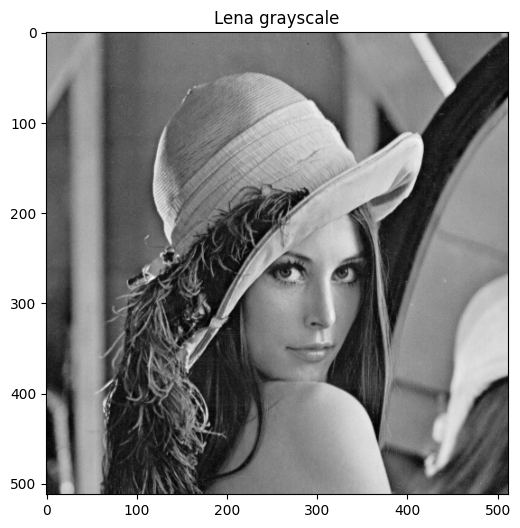

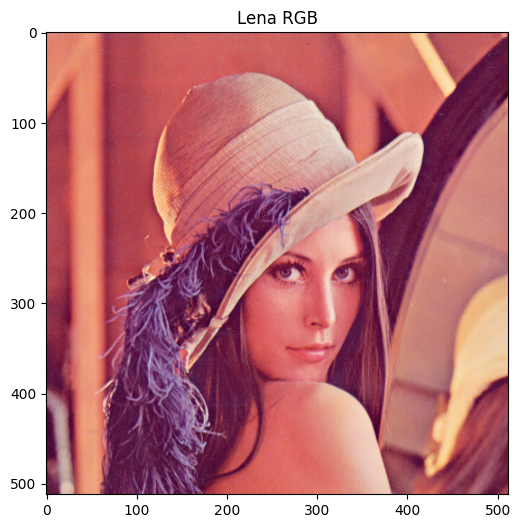

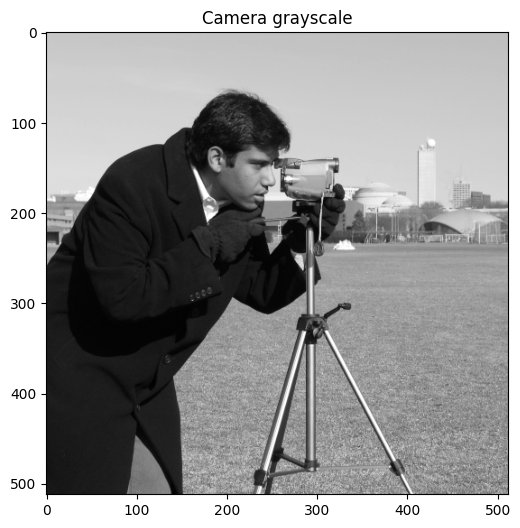

In [ ]:
# Φέρνουμε την εικόνα Lena 
HTTP_response = urllib.request.urlopen('http://www.image.ntua.gr/~tpar/LABimage/lena.png')

arr = np.asarray(bytearray(HTTP_response.read()), dtype=np.uint8)
BGR = cv2.imdecode(arr,-1)

# Μετατρέπουμε σε Gray
Lena_gray = cv2.cvtColor(BGR, cv2.COLOR_BGR2YCrCb)[:,:,0]
plt.figure(figsize=(6, 6))
plt.imshow(Lena_gray, cmap="gray")
plt.title('Lena grayscale')

# Διατήρηση χρώματος, μετατρέπουμε σε RGB
Lena_RGB = cv2.cvtColor(BGR, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(6, 6))
plt.imshow(Lena_RGB)
plt.title('Lena RGB')

Camera=skimage.data.camera()
plt.figure(figsize=(6, 6))
plt.imshow(Camera, cmap="gray")
plt.title('Camera grayscale')

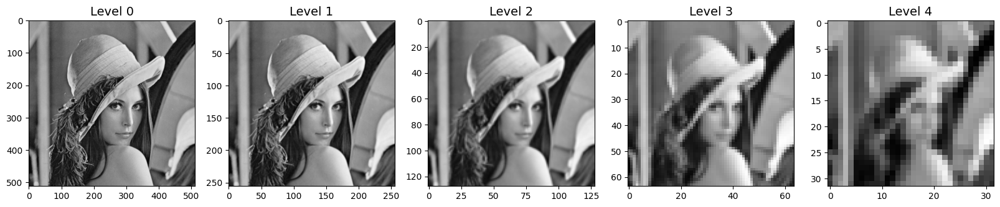

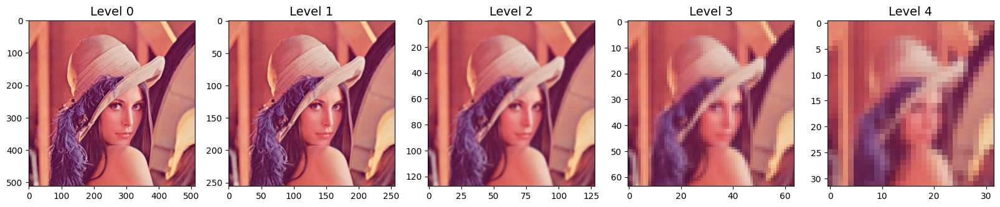

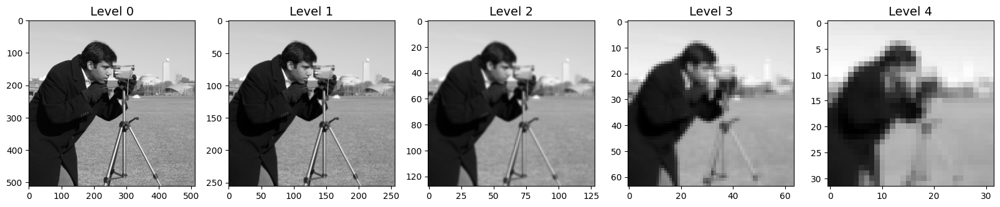

In [ ]:
# Υπολογισμός και τύπωμα Gaussian πυρμαίδας για κάθε εικόνα

# Lena Grayscale
Lena_gray_gaus=GPyramid(Lena_gray,0.4,5)
showPyramid(Lena_gray_gaus,'gray')
# Lena RGB
Lena_RGB_gaus=GPyramid(Lena_RGB,0.4,5)
showPyramid(Lena_RGB_gaus,'gray')
# Camera
Camera_gaus=GPyramid(Camera,0.4,5)
showPyramid(Camera_gaus,'gray')

#Ζήτημα α

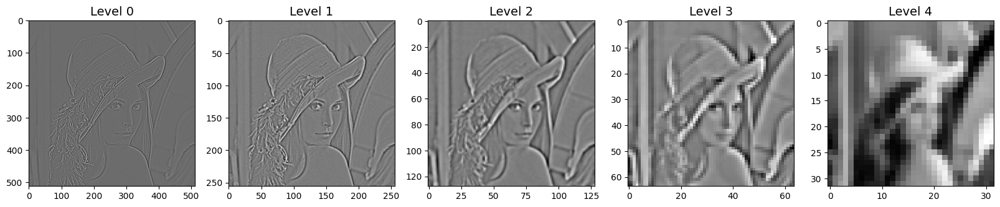

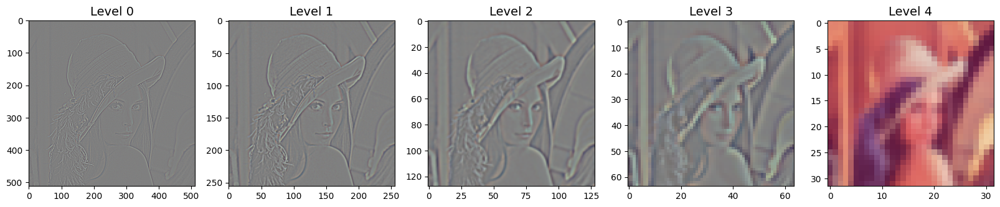

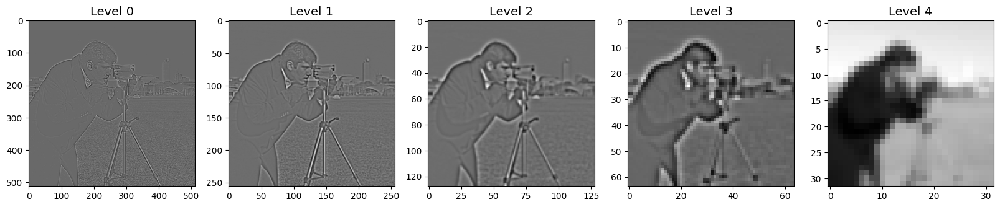

In [ ]:
#Laplacian πυραμίδα

# Lena Grayscale
Lena_gray_lap=LPyramid(Lena_gray,3/8,5)
showPyramid(Lena_gray_lap, 'gray')
# Lena RGB
Lena_RGB_lap=LPyramid(Lena_RGB,3/8,5)
showPyramid(Lena_RGB_lap,'RGB')
# Camera
Camera_lap=LPyramid(Camera,3/8,5)
showPyramid(Camera_lap,'gray')
     

Text(0.5, 1.0, 'Original')

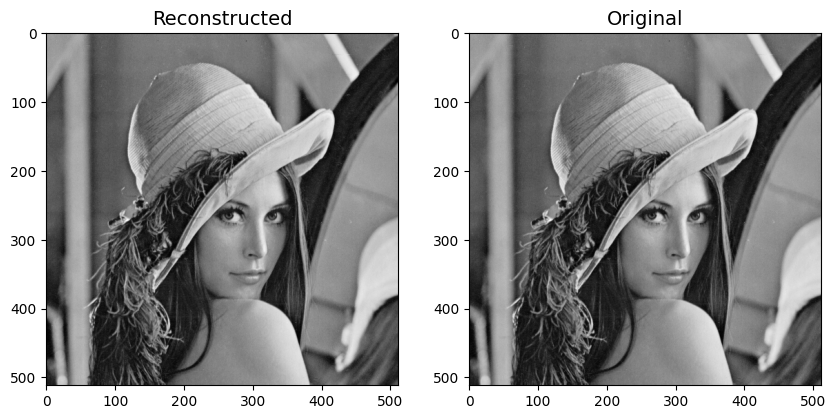

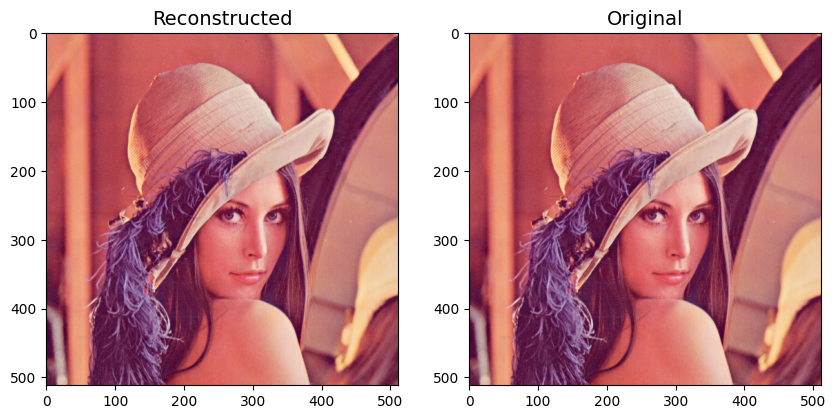

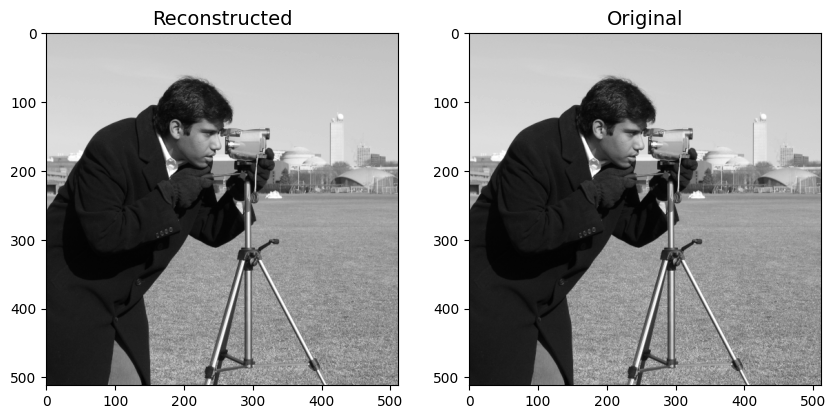

In [ ]:
# Σχεδιασμός ανακατασκευασμένων εικόνων 

# Lena Grayscale
Lena_gray_dec=L_Pyramid_Decode(Lena_gray_lap,3/8)
f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Lena_gray_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_gray, cmap="gray")
ax1.set_title('Original', fontsize=14)
# Lena RGB
Lena_RGB_dec=L_Pyramid_Decode(Lena_RGB_lap,3/8)
f2, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Lena_RGB_dec.astype(int), cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_RGB, cmap="gray")
ax1.set_title('Original', fontsize=14)
# Camera
Camera_dec=L_Pyramid_Decode(Camera_lap,3/8)
f3, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Camera_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Camera, cmap="gray")
ax1.set_title('Original', fontsize=14)

In [ ]:
# Ελέγχουμε αν η ανακατασκευή είναι χωρίς απώλειες
print('Is reconstruction exact for Lena grayscale?', (Lena_gray==Lena_gray_dec).all())
print('Is reconstruction exact for Lena RGB?',(Lena_RGB==Lena_RGB_dec).all())
print('Is reconstruction exact for Camera?',(Camera==Camera_dec).all())

Is reconstruction exact for Lena grayscale? True
Is reconstruction exact for Lena RGB? True
Is reconstruction exact for Camera? True


Η ανακατασκευή των εικόνων από την Λαπλασιανή πυραμίδα γίνεται χωρίς απώλειες, με την προϋπόθεση ότι χρησιμοποιούμε την ίδια παράμετρο α και για την κωδικοποίηση και την αποκωδικοποίηση.

# Ζήτημα β

Εμφανίζουμε την Λαπλασιανή πυραμίδα για μεταβλητό α στο διάστημα [0.2,..., 0.7] με βήμα 0.1 και παρουσιάζουμε πυραμίδες 5 επιπέδων.

In [ ]:
# Συνάρτηση για να δείξουμε την πυραμίδα για διαφορετικές τιμές της παραμέτρου a
def showLaplacianForValuesOfa(I_original):                                          
    for a in range (3,8):
        a=a/10
        pyramid=LPyramid(I_original,a,5)                                            # Υπολογίζουμε την Laplacian πυραμίδα για συγκεκριμένο a
        if (len(I_original.shape)==2):                                              # Αν η εικόνα είναι Grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))               # Σχεδιασμός πυραμίδων
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i], cmap="gray") 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                        # Αλλιώς αν η εικόνα είναι RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))                # Σχεδιασμός πυραμίδων
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i].astype(int)) 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

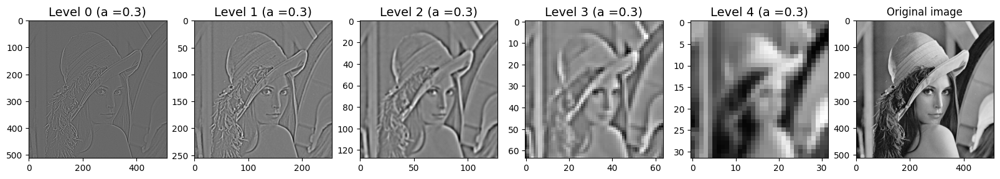

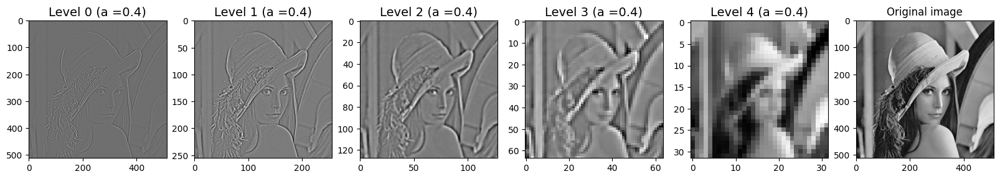

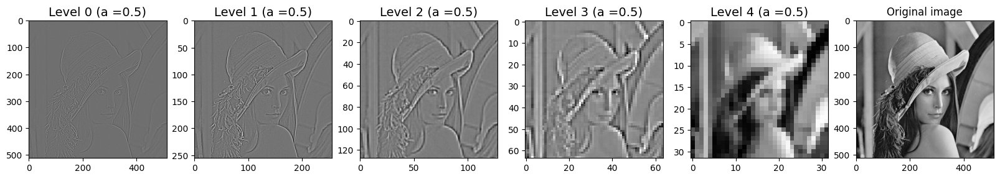

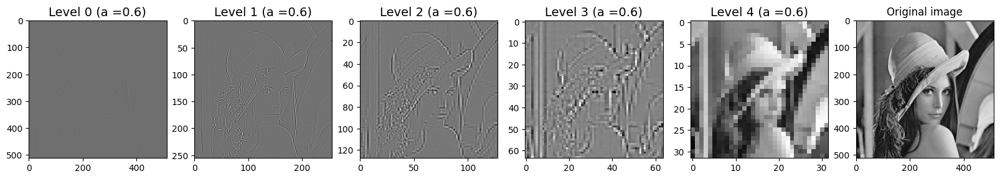

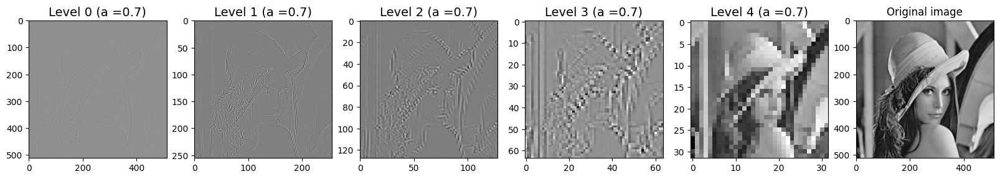

...

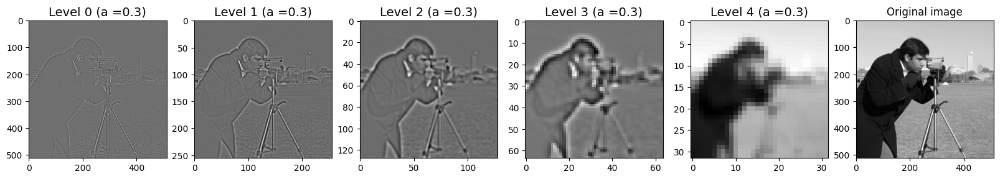

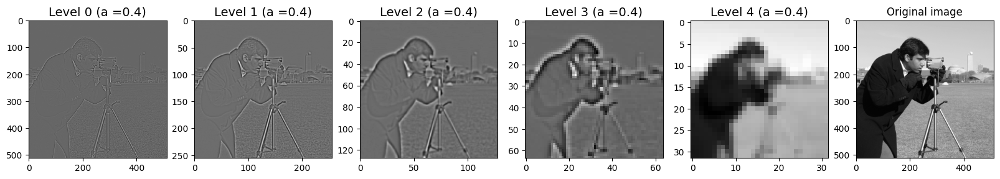

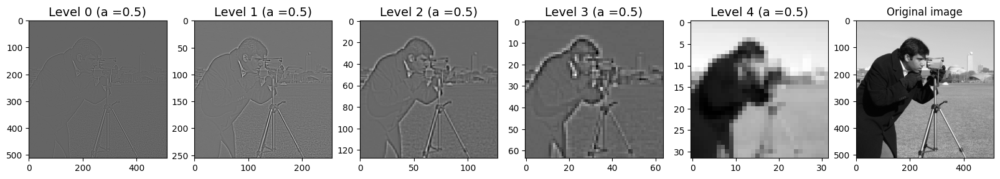

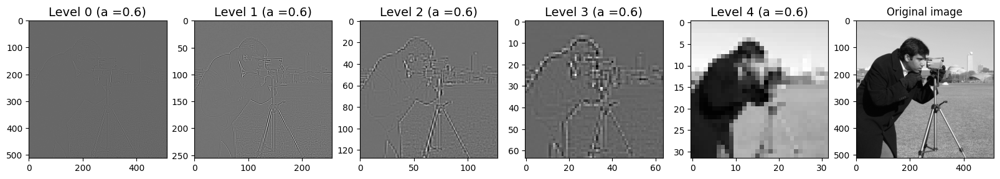

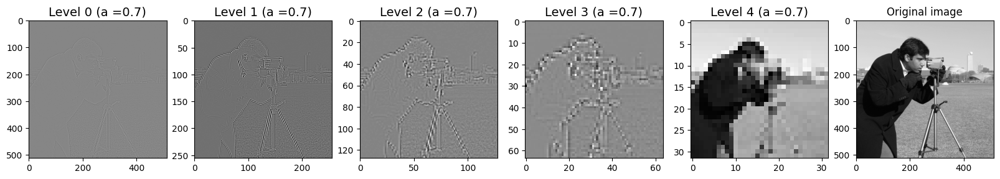

In [ ]:
Lena_gray_decoded=showLaplacianForValuesOfa(Lena_gray)
Lena_RGB_decoded=showLaplacianForValuesOfa(Lena_RGB)
Camera_decoded=showLaplacianForValuesOfa(Camera)

Παρατηρούμε ότι όσο αυξάνεται η τιμή του α τόσο χαλάει η ποιότητα των εικόνων της πυραμίδας. Λογικό, αφού η τιμή του α επηρεάζει την μορφή του πυρήνα κι έτσι μεγαλύτερες τιμές οδηγούν σε μεγαλύτερη συμμετοχή των κεντρικών pixel από τα ακριανά στον υπολογισμό του σταθμισμένου μέσου όρου. Έτσι, οι μεταβάσεις γίνονται λιγότερο ομαλές.

In [ ]:
# Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει
def L_Pyramid_Show_Decode_Levels(L,a):                                           # Παράμετροι εισόδου είναι η Laplacian πυραμίδα και η τιμή του a
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if (len(sum_image.shape)==2):                                                # Grayscale εικόνα
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray')                          # Δείξε την lowpass εικόνα. Πάνω επίπεδο της πυραμίδας.
    else:
      ax[0].imshow(L[len(L)-1].astype(int))                                      # Χρώμα εικόνας                                  
    ax[0].set_title('Level {} '.format(len(L)-1)+'(a ='+str(a)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                               # EXPAND εικόνας για να λάβουμε τις ίδιες διαστάσεις όπως το προηγούμενο επίπεδο
        sum_image=L[i]+expanded_image-128                                        # Άθροισμα του προηγούμενου επιπέδου στο συνολικό άθροισμα εικόνας που μέχρι τώρα έχει υπολογιστεί
        if (len(sum_image.shape)==2):
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                      # Δείξε την συνολική εικόνα
        else:
          ax[tmp].imshow(sum_image.astype(int)) 
        ax[tmp].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)             
    return sum_image 

In [ ]:
# Συνάρτηση για να καλέσει την L_Pyramid_Show_Decode_Levels για διαφορετικές τιμές του a
def showDecoded(I_original):                                                     # Παράμετρος εισόδου είναι η αρχική εικόνα
    for a in range (2,8):
        a=a/10
        pyramid=LPyramid(I_original,a,5)
        L_Pyramid_Show_Decode_Levels(pyramid,a)

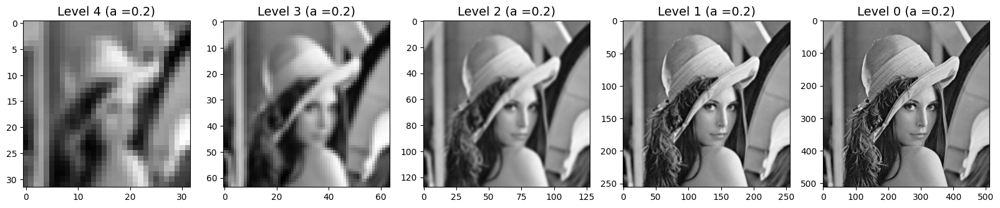

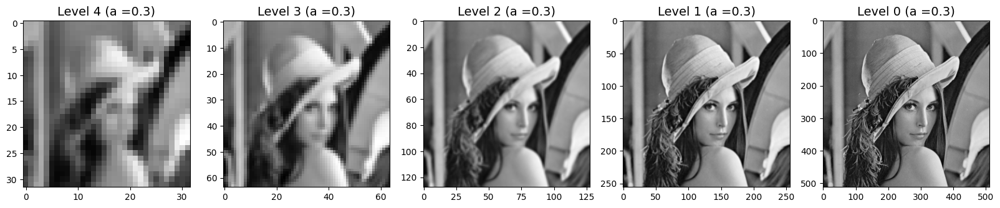

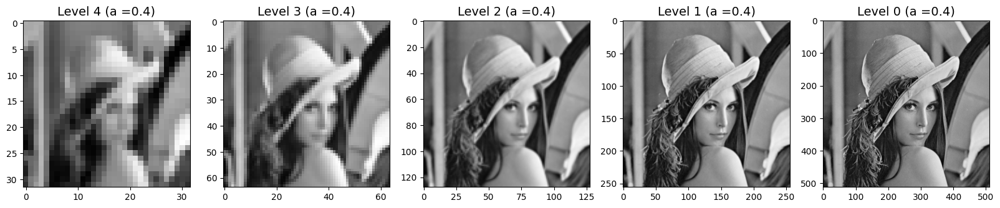

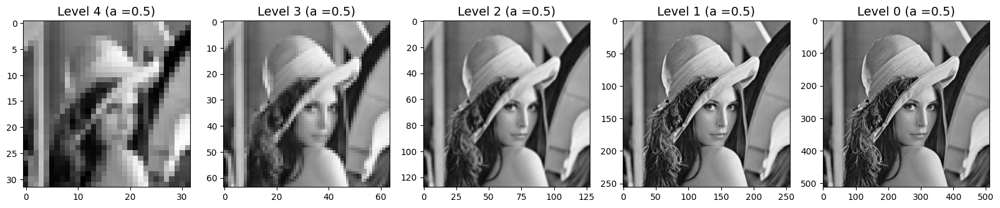

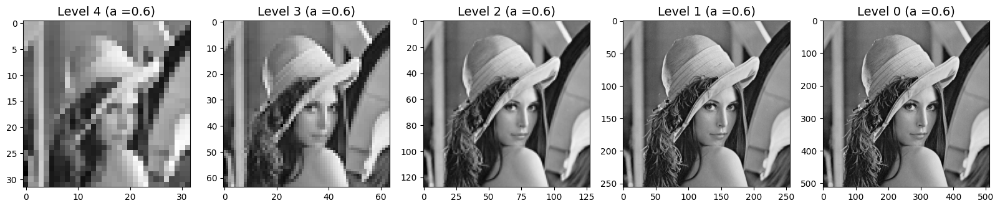

...

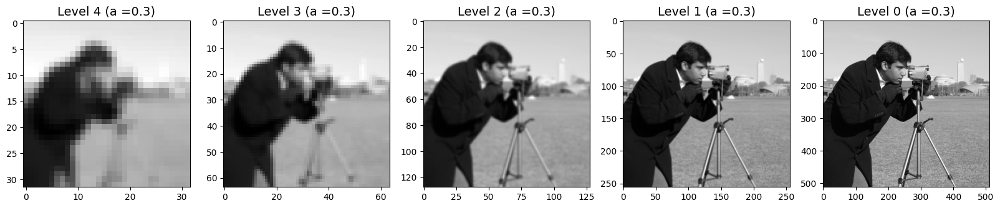

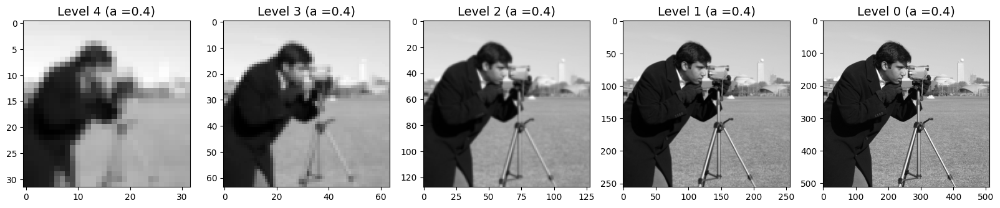

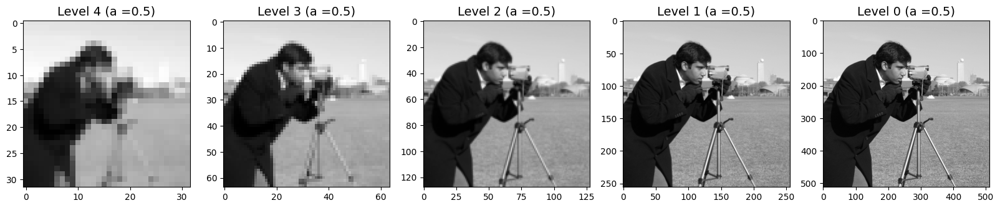

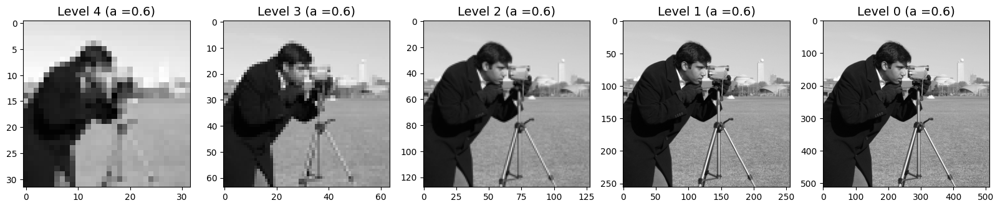

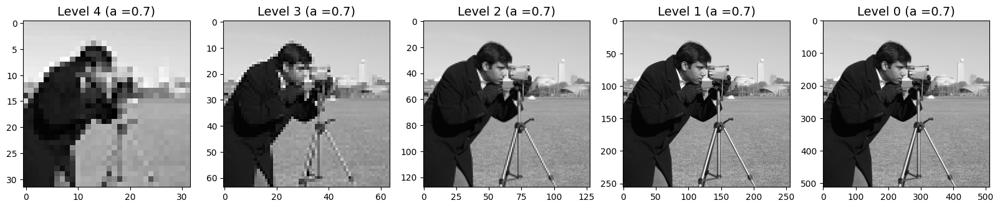

In [ ]:
showDecoded(Lena_gray)
showDecoded(Lena_RGB)
showDecoded(Camera)

# Ζήτημα γ


Εμφανίζουμε την Λαπλασιανή πυραμίδα για μεταβλητό α στο διάστημα [2,..., 7] με βήμα 1

In [ ]:
# Συνάρτηση για να δείξουμε την πυραμίδα διαφορετικών τιμών βάθους
def showLaplacianForDepths(I_original):    
    for d in range (2,8):
        pyramid=LPyramid(I_original,3/8,d)                                          # Υπολογισμός πυραμίδας για συγκεκριμένο βάθος
        if (len(I_original.shape)==2):                                              # Αν η εικόνα είναι Grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        # Σχεδιασμός των πυραμίδων
                ax[i].imshow(pyramid[i], cmap="gray")                               # Βάση της πυραμίδας
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                       # Αν η εικόνα είναι RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        # Σχεδιασμός των πυραμίδων
                ax[i].imshow(pyramid[i].astype(int))                                # Βάση της πυραμίδας
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

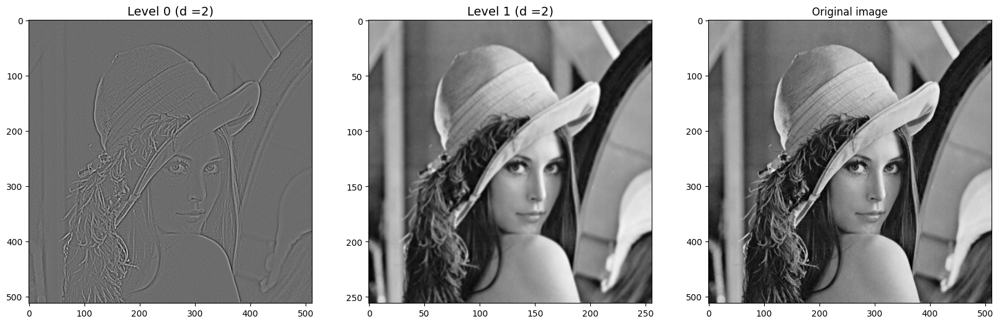

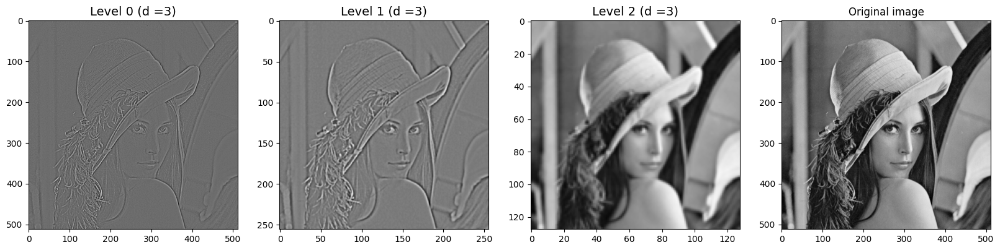

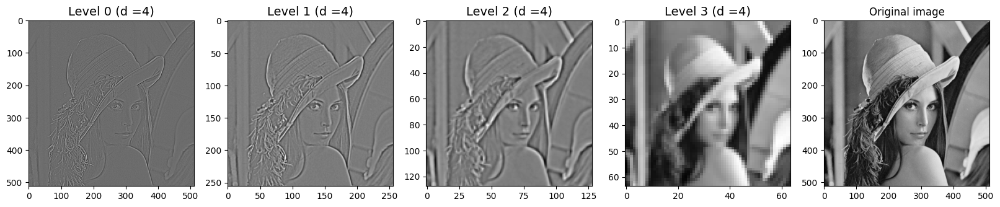

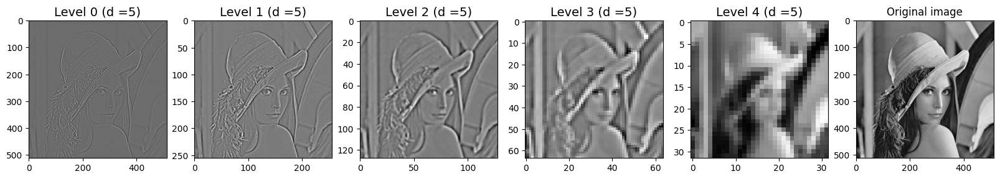

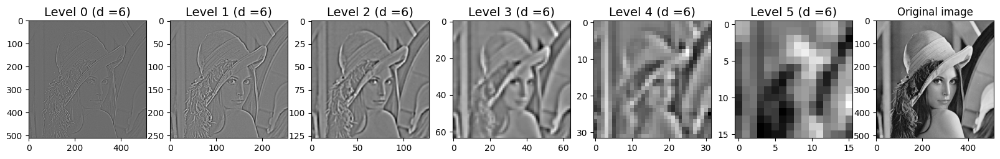

In [ ]:
Lena_gray_decoded=showLaplacianForDepths(Lena_gray)
Lena_RGB_decoded=showLaplacianForDepths(Lena_RGB)
Camera_decoded=showLaplacianForDepths(Camera)

Με αύξηση του αριθμού επιπέδων έχουμε το χειρότερο αποτέλεσμα στο τελικό επίπεδο. Για μικρό αριθμό επιπέδων της πυραμίδας η κορυφή κωδικοποιεί περισσότερη πληροφορία με μεγαλύτερη μέγιστη συχνότητα από την κορυφή της πυραμίδας περισσότερων επιπέδων. Έτσι, πετυχαίνονται ετός από μεγαλύτερες διαστάσεις και περισσότερη λεπτομέρεια. Όσο αυξάνουμε τον αριθμό επιπέδων έχουμε χωρισμό της εικόνας σε πολλά ζωνοπερατά τμήματα-επίπεδα λεπτομέρειας.

In [ ]:
# Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει
def L_Pyramid_Show_Decode_Levels_forDepths(L,a,depth):                           # Παράμετροι εισόδου είναι η Laplacian pyramid, η τιμή του a και το βάθος της πυραμίδας
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if(len( sum_image.shape)==2):
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray')                          # Δείξε την lowpass εικόνα. Κορυφή της πυραμίδας.
    else:
      ax[0].imshow(L[len(L)-1].astype(int))                                      # Κορυφή της πυραμίδας
    ax[0].set_title('Level {} '.format(len(L)-1)+'(d ='+str(depth)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                               # EXPAND εικόνας για να λάβουμε τις ίδιες διαστάσεις όπως το προηγούμενο επίπεδο
        sum_image=L[i]+expanded_image-128                                        # sum previous level to the sum image calculated so far, substract 128, added earlier
        if(len(sum_image.shape)==2):                                             # Grayscale εικόνα
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                      # Δείξε την συνολική εικόνα
        else:                                                                    # Χρώμα εικόνας
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')
        ax[tmp].set_title('Level {} '.format(i)+'(d ='+str(depth)+')', fontsize=14)             
    return sum_image  

In [ ]:
def showDecodedForDepths(I_original):
    for d in range (2,8):
        pyramid=LPyramid(I_original,3/8,d)
        L_Pyramid_Show_Decode_Levels_forDepths(pyramid,3/8,d)

In [ ]:
showDecodedForDepths(Lena_gray)
showDecodedForDepths(Lena_RGB)
showDecodedForDepths(Camera)

# Ζήτημα δ

In [ ]:
import scipy.stats as st


In [ ]:
# Συνάρτηση που υπολογίζει ιστογράμματα για συγκεκριμένη πυραμίδα και βάθος
def computeSumHist(LaplacianPyramid,depth):  
    sum_hist = np.zeros([256,1], np.float64)
    for n in range(depth-1):
        hist = cv2.calcHist(np.float32([LaplacianPyramid[n]]), [0], None, [256], [0, 256])       # Υπολογισμός ιστογράμματος για κάθε επίπεδο και πρόσθεση του σε έναν πίνακα
        sum_hist += hist
    return sum_hist

# Συνάρτηση που υπολογίζει πυραμίδα και ιστόγραμμα για συγκεκριμένη τιμή της παραμέτρου a και βάθος
def calcHist (Image,a,depth):  
    LaplacianPyramid=LPyramid(Image,a,depth)                                     # Υπολογισμός πυραμίδας
    sum_hist = computeSumHist(LaplacianPyramid,depth)                            # Υπολογισμός ιστρογράμματος
    return sum_hist

# Συνάρτηση που δείνχει ιστογράμμα με τιμές της παραμέτρου a σε εύρος [0.2, 0.7]
def ShowHistogramsFora (Image,depth):  
    final_sum_hist=[]                                                            # Πίνακας που κρατάει τα ιστογράμματα για κάθε τιμή της παραμέτρου a
    entropy=[]
    variance=[]
    for i in range (2,8):
        i=i/10
        helper=calcHist(Image,i,depth)                                           # Υπολογισμός ιστρογράμματος
        a=np.max(helper)                                                         # Υπολογισμός μέγιστης τιμής ιστογράμματος
        final_sum_hist.append(helper)           
        entropy.append(st.entropy(helper/a)[0])                                  # Υπολογισμός εντροπίας κανονικοποιημένου ιστογράμματος
        variance.append(np.var(helper/a))                                        # Υπολογισμός διακύμανσης κανονικοποιημένου ιστογράμματος
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=0.1
    for i in range (1,7):
        c += 0.1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                            # Διαγραμματοποίηση κάθε ιστογράμματος
        plt.title("Entropy = "+str(entropy[i-1])+" (a="+str(round(c,1))+")", fontsize=14) 
    return entropy,variance

# Συνάρτηση που δείνχει ιστογράμματα με μεταβλητό βάθος μεταξύ [2,7]        
def ShowHistogramsFordepth (Image,a):  
    final_sum_hist=[]                                                            # Πίνακας που κρατάει τα ιστρογράμματα κάθε βάθους
    entropy=[]
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                               # Υπολογισμός ιστρογράμματος
        b=np.max(helper)                                                         # Υπολογισμός μέγιστης τιμής ιστογράμματος
        final_sum_hist.append(helper)
        entropy.append(st.entropy(helper/b)[0])                                  # Υπολογισμός εντροπίας κανονικοποιημένου ιστογράμματος
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=1
    for i in range (1,7):
        c += 1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                            # Διαγραμματοποίηση κάθε ιστογράμματος
        plt.title("Entropy = "+str(entropy[i-1])+" (depth="+str(c)+")", fontsize=14) 
    return entropy

Για μεταβλητό a παρουσιάζουμε τα κανονικοποιημένα ιστογράμματα (βάθος πυραμίδας επιλέχθηκε 5).



In [ ]:
[entropy_lena_grey,variance_lena_grey]=ShowHistogramsFora(Lena_gray,5) 
[entropy_lena_rgb,variance_lena_rgb]=ShowHistogramsFora(Lena_RGB,5) 
[entropy_camera,variance_camera]=ShowHistogramsFora(Camera,5) 

In [ ]:
# Συνάρτηση που υπολογίζει την εντροπία και την διακύμανση και τις διαγραμματοποιεί για συγκεκριμένο βάθος
def computeEntropyVariance (Image,depth,title):
    final_sum_hist=[]
    probs = [0.2,0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1]  # Πίνακας που αποθηκεύει τις τιμές του x άξονα
    entropy=[]
    variance=[]
    tmp=0
    for i in range (0,17):
        tmp=probs[i]
        helper=calcHist(Image,tmp,depth)                                         # Υπολογισμός ιστρογράμματος για κάθε τιμή βάθους
        a=np.max(helper)                                                         # Υπολογισμός μέγιστης τιμής του ιστογράμματος
        final_sum_hist.append(helper/a)
        entropy.append(st.entropy(helper/a)[0])                                  # Υπολογισμός εντροπίας κανονικοποιημένου ιστογράμματος 
        variance.append(np.var(helper/a))                                        # Υπολογισμός διακύμανσης κανονικοποιημένου ιστογράμματος 
    f, ax = plt.subplots(1, 2, figsize=(15, 4) ) 
    plt.subplot(1,2,1)
    plt.plot(probs, entropy, marker='.')                                         # Διαγραμμοποίησης εντροπίας
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Entropy')
    plt.subplot(1,2,2)
    plt.plot(probs, variance, marker='.')                                        # Διαγραμμοποίηση διακύμανσης
    plt.title('Variance of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Variance')
    plt.show()
    return entropy,variance
     

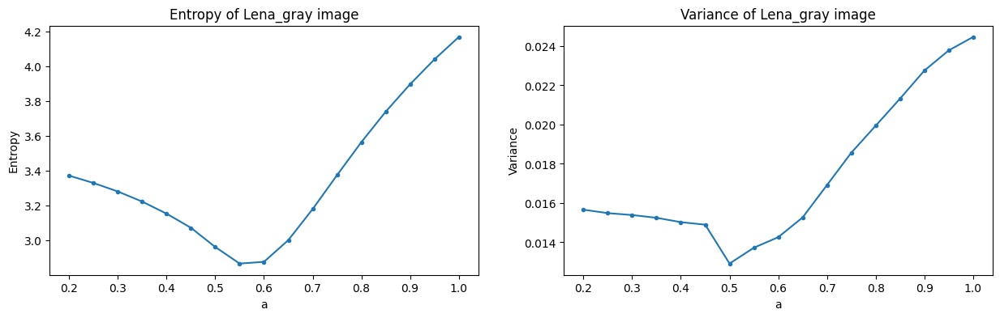

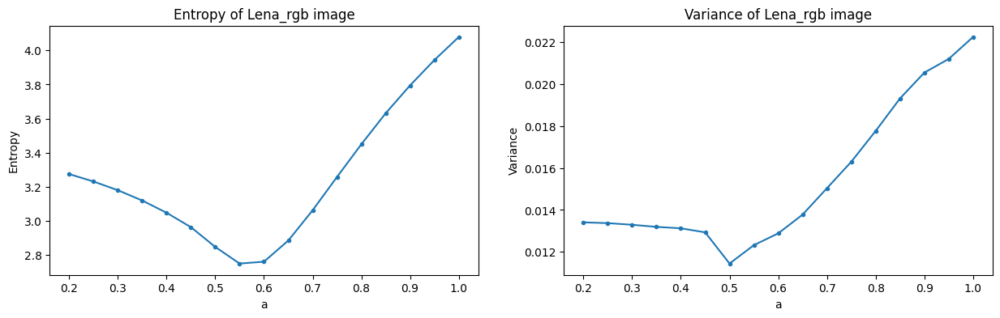

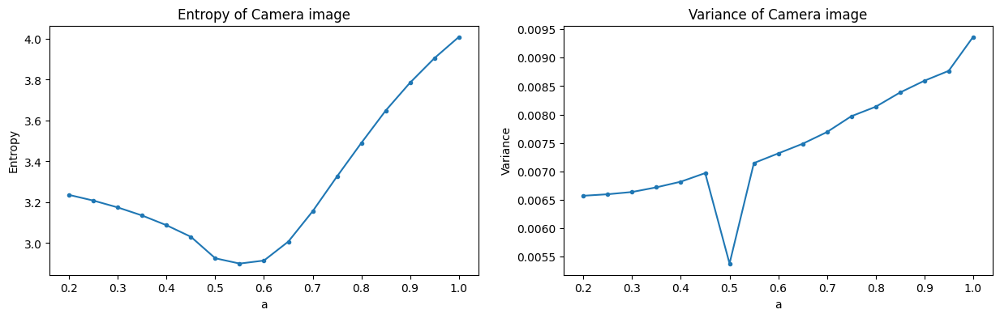

In [ ]:
[entropy_lena_grey,variance_lena_grey]=computeEntropyVariance(Lena_gray,5,"Lena_gray")
[entropy_lena_rgb,variance_lena_rgb]=computeEntropyVariance(Lena_RGB,5,"Lena_rgb")
[entropy_camera,variance_camera]=computeEntropyVariance(Camera,5,"Camera")

Η εντροπία παρουσιάζει τοπικό ελάχιστο το οποίο μεταβάλλεται ανάλογα την εικόνα παραμένοντας σε χαμηλό επίπεδο. Αναμενόμενο δεδομένης της αποσυσχέτισης των pixel των εικόνων της Laplacian πυραμίδας. Παρατηρούμε ότι το variance παρουσιάζει ελάχιστο για a = 0.5. Άρα συμπεραίνουμε ότι για τιμές στο [0.5, 0.7] μπορούμε να πετύχουμε αρκετά χαμηλή τιμή τόσο στην εντροπία όσο και στην διακύμανση. Έτσι, μας επιτρέπεται να έχουμε ελάχιστο αριθμό bits/pixel που χρειάζονται για την κωδικοποίηση της εκάστοτε εικόνας.

Με μεταβλητό depth έχουμε τα παρακάτω.

In [ ]:
entropy_lena_gray=ShowHistogramsFordepth(Lena_gray,3/8)
entropy_lena_rgb=ShowHistogramsFordepth(Lena_RGB,3/8)
entropy_camera=ShowHistogramsFordepth(Camera,3/8)

In [ ]:
# Συνάρτη που υπολογίζε την εντροπία για συγκεκριμένη τιμή της παραμέτρου a
def computeEntropyVarianceDepth (Image,a,title):
    entropy=[]
    probs=np.arange(2,8,1)                                                                    # Πίνακας που αποθηκεύει τις τιμές του x άξονα
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                                            # Υπολογισμός ιστρογράμματος για συγκεκριμένο βάθος
        b=np.max(helper)                                                                      # Υπολογισμός μέγιστης τιμής του ιστογράμματος 
        entropy.append(st.entropy(helper/b)[0])                                               # Υπολογισμός εντροπίας για το κανονικοποιημένο ιστόγραμμα
    plt.plot(probs, entropy, marker='.')                                                      # Διαγραμμοποίηση εντροπίας
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('depth')
    plt.ylabel('Entropy')
    return entropy

In [ ]:
entropy_lena_grey=computeEntropyVarianceDepth(Lena_gray,3/8,"Lena_grayscale")
entropy_lena_rgb=computeEntropyVarianceDepth(Lena_RGB,3/8,"Lena_rgb")
entropy_camera=computeEntropyVarianceDepth(Camera,3/8,"Camera")

Η παράμετρος depth δεν επηρεάζει σε μεγάλο βαθμό την εντροπία καθώς βλέπουμε ότι υπάρχει μια μικρή μεταβολή.

# Ζήτημα ε

In [ ]:
# Σταθερά c
const_c = 0.85
# Σταθερή βάση για την εντροπία
const_entropy_base = 2

# Παρόμοια συνάρτηση της sumHist
def listHist(Image,a,depth):
    LaplacianPyramid = LPyramid(Image,a,depth)
    list_hist = []
    for n in range(depth):
        hist = cv2.calcHist(np.float32([LaplacianPyramid[n]]), [0], None, [256], [0, 256])
        list_hist.append(hist)
    return list_hist

# Συνάρτηση για να υπολογίσουμε την εντροπία και την διακύμανση από ιστρογράμματα
def histList2EntrAndVar(list_hist):
  entropy_list = list(map(lambda x: st.entropy(x)[0], list_hist))
  variance_list = list(map(lambda x: np.var(x/np.max(x)), list_hist))
  return entropy_list, variance_list

# Σταθμισμένος μέσος όρος της δοθείσας λίστα που αναπαριστά τα επίπεδα της Laplacian πυραμίδας, κάθε επίπεδο σταθμίζεται από το πλήθος των pixels (μέγεθος)
def avgW(LPlayers_list):
  weighted_sum = 0
  l_len = len(LPlayers_list)
  for i in range (l_len):
    weighted_sum += LPlayers_list[l_len-1-i] * 4**i    # Αφού κάθε επίπεδο έχει 4 φορές το μέγεθος του προηγούμενου, τα βάρη είναι 1, 4, 16... ξεκινώντας από τη μικρότερη εικόνα 
  sum_of_weights = (4*4**(l_len-1)-1)/3
  return weighted_sum / sum_of_weights

# Δοθείσα εικόνα, παράμετρος a, depth return AvgEntropy and AvgVariance
def avgEnVar(Image,a,depth):
  hists = listHist(Image,a,depth)
  entropy_l, variance_l = histList2EntrAndVar(hists)
  return avgW(entropy_l), avgW(variance_l)

def range_with_floats(start, stop, step):
    while stop > start:
        yield start
        start += step

def cost(Image, a_start, a_step, a_end, depth, title):
  a_list = []
  var_list = []
  en_list = []
  cost_list = []
  for a in range_with_floats(a_start, a_end, a_step):
    en, var = avgEnVar(Image,a,depth)
    en_list.append(en)
    var_list.append(var)
    a_list.append(a)

  en_norm = np.max(en_list) - np.min(en_list)
  var_norm = np.max(var_list) - np.min(var_list)

  for i in range(len(a_list)):
    cost_list.append(const_c*en_list[i]/en_norm + (1-const_c)*var_list[i]/var_norm)

  # Σχεδιασμός/Διαγράμματα
  f, ax = plt.subplots(1, 3, figsize=(12, 4))
  plt.subplot(1,3,1)
  plt.plot(a_list, en_list, marker='.')
  plt.title('Entropy of '+str(title)+' image')
  plt.xlabel('a')
  plt.ylabel('Entropy')
  plt.subplot(1,3,2)
  plt.plot(a_list, var_list, marker='.')
  plt.title('Variance of '+str(title)+' image')
  plt.xlabel('a')
  plt.ylabel('Variance')
  plt.subplot(1,3,3)
  plt.plot(a_list, cost_list, marker='.')
  plt.title('Cost of '+str(title)+' image')
  plt.xlabel('a')
  plt.ylabel('Cost Function')
  return cost_list, a_list


def presentation_e(Image, a_start, a_step, a_end, depth, title):
  costs, a_list = cost(Image, a_start, a_step, a_end, depth, title)
  min_pos = np.argmin(costs)
  print("Minimum Cost for " + title + " is:\n" + str(costs[min_pos]) + " at a="+ str(np.round(a_list[min_pos], decimals=3)))

In [ ]:
presentation_e(Lena_gray, 0.3, 0.03, 0.7, 9, "Lena Gray")
presentation_e(Lena_RGB, 0.3, 0.03, 0.7, 9, "Lena RGB")
presentation_e(Camera, 0.3, 0.03, 0.7, 9, "Camera Gray")

# Ζήτημα στ

Σε αυτό το ερώτημα υλοποιούμε δύο συναρτήσεις κβαντισμού για τα αντίστοιχα πειράματα. Σε μεγαλύτερα επίπεδα θα πρέπει να έχουμε μικρότερο bin size. Για την επιλογή του bin size διαλέγουμε τη τιμή που μόλις αρχίζει να φαίνεται η υποβάθμιση της ποιότητας σε σχέση με την μη κβαντισμένη εικόνα για το επίπεδο αυτό. Κάνουμε δύο πειράματα για την εξετάσουμε την προτεινόμενη μέθοδο.

*   Bin size τέτοιο ώστε να είναι μόλις εμφανής η υποβάθμιση σε κάθε επίπεδο
*   Bin size τέτοιο ώστε να είναι πιο έντονη η υποβάθμιση σε κάθε επίπεδο.

In [ ]:
# Συνάρτηση για να υπολογιστεί η κβαντισμένη πυραμίδα του πρώτου πειράματος
def firstExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[14,23,40,45,48]                                                                # Bin sizes για το πρώτο πείρμαμα
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               # Υπολογισμός κβαντισμένης πυραμίδας
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [ ]:
# Συνάρτηση για να υπολογιστεί η κβαντισμένη πυραμίδα του δεύτερου πειράματος
def secondExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid)  
    bins=[8,14,22,26,27]                                                                 # Bin sizes για το δεύτερο πείραμα
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               # Υπολογισμός κβαντισμένης πυραμίδας
        quantized_lap.append(image_quantized)  
    return quantized_lap
     

In [ ]:
# Συνάρτηση για να υπολογιστεί η κβαντισμένη πυραμίδα του τρίτου πειράματος
def thirdExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[25,40,58,64,65]                                                                # Bin sizes για το τρίτο πείραμα
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               # Υπολογισμός κβαντισμένης πυραμίδας
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [ ]:
# Αρχική πυραμίδα
Lena_gray_lap=LPyramid(Lena_gray,0.57,5)
showPyramid(Lena_gray_lap, 'gray')
# Πρώτο πείραμα
Lena_gray_lap_quant_first=firstExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_first, 'gray')
# Δεύτερο πείραμα
Lena_gray_lap_quant_second=secondExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_second, 'gray')

In [ ]:
# Συνάρτηση για να παραθέσουμε την ανακατασκευασμένη εικόνα δίπλα στην αρχική
def showExperimentsDecoded(original,quant_f,quant_s,a,type):
    quantized=[quant_f,quant_s]                                          # Λαμβάνει ως είσοδο την κβαντισμένη εικόνα των τριών πειραμάτων
    exp=["first","second"]
    Decoded=[]
    for i in range (2):
        Decoded.append(L_Pyramid_Decode(quantized[i],a))                         # Αποκωδικοποίηση κάθε κβαντισμένης εικόνας
        f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
        if (type=="gray"):                                                       # Αν η εικόνα είναι Grayscale
            ax0.imshow(Decoded[i], cmap="gray")                                  # Σχεδιασμός ανακατασκευασμένης εικόνας
            ax0.set_title('Reconstructed from '+str(exp[i])+" experiment", fontsize=10)
            ax1.imshow(original, cmap="gray")                                    # Σχεδιασμός αρχικής εικόνας
            ax1.set_title('Original', fontsize=10)
        else:                                                                    # Αν η εικόνα είναι RGB
            ax0.imshow(Decoded[i].astype(int))                                   # Σχεδιασμός ανακατασκευασμένης εικόνας
            ax0.set_title('Reconstructed', fontsize=14)
            ax1.imshow(original)                                                 # Σχεδιασμός αρχικής εικόνας
            ax1.set_title('Original', fontsize=14)
    return Decoded

In [ ]:
Lena_gray_decoded=showExperimentsDecoded(Lena_gray,Lena_gray_lap_quant_first,Lena_gray_lap_quant_second,0.57,'gray')


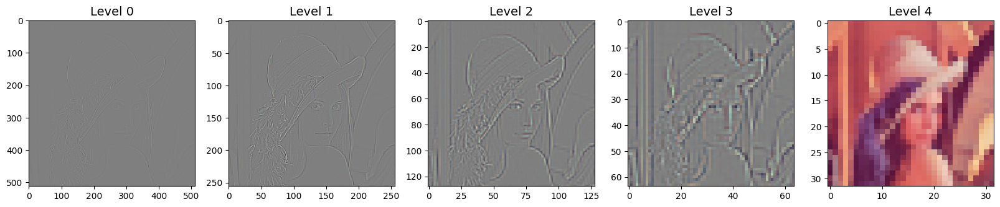

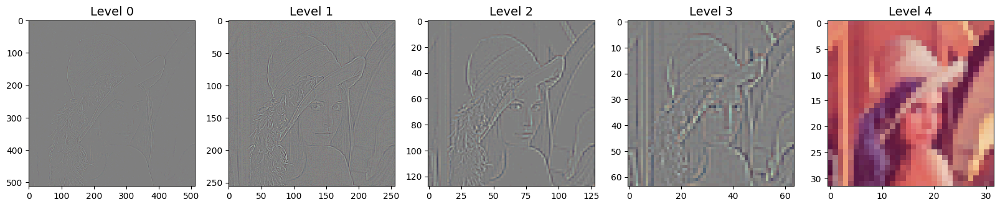

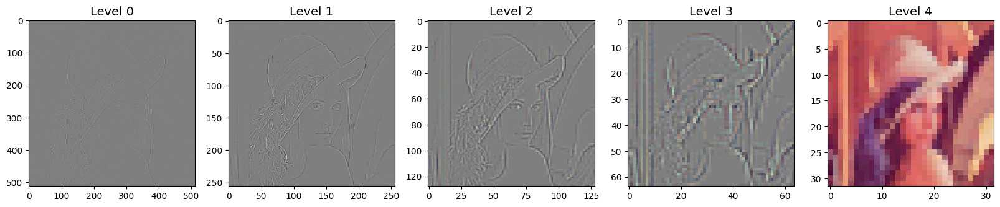

In [ ]:
Lena_rgb_lap=LPyramid(Lena_RGB,0.57,5)
showPyramid(Lena_rgb_lap, 'RGB')

Lena_rgb_lap_quant_first=firstExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_first, 'RGB')

Lena_rgb_lap_quant_second=secondExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_second, 'RGB')


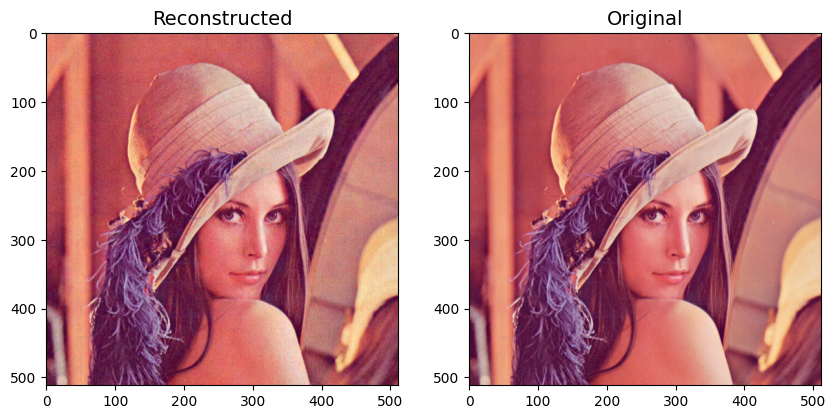

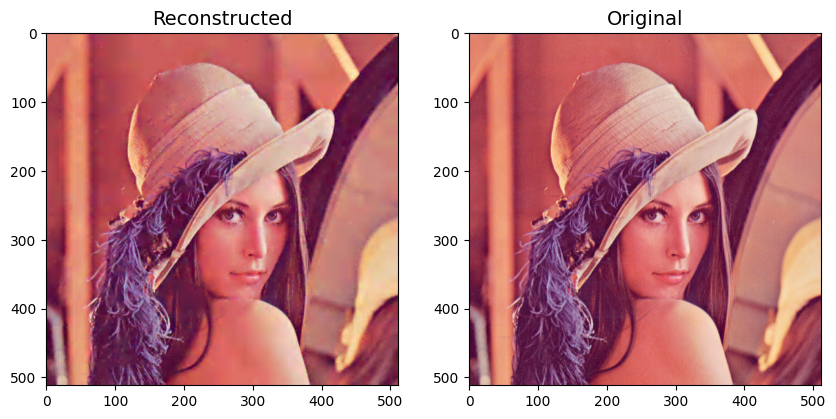

In [ ]:
Lena_rgb_decoded=showExperimentsDecoded(Lena_RGB,Lena_rgb_lap_quant_first,Lena_rgb_lap_quant_second,0.57,'rgb')


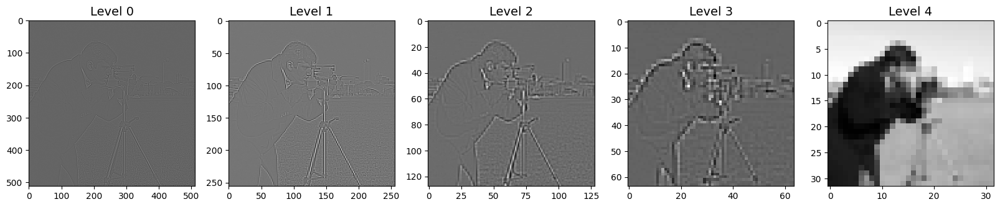

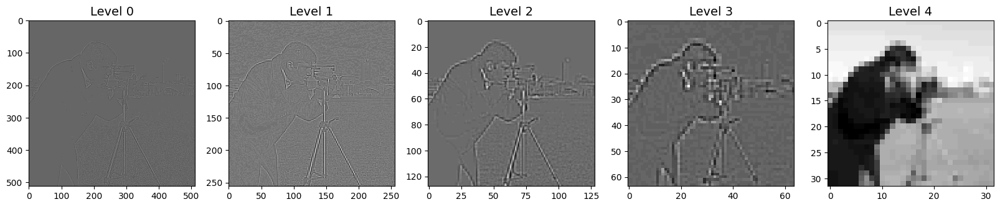

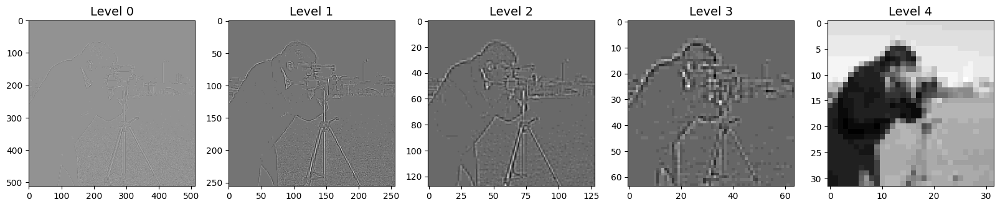

In [ ]:
Camera_gray_lap=LPyramid(Camera,0.57,5)
showPyramid(Camera_gray_lap, 'gray')

Camera_gray_lap_quant_first=firstExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_first, 'gray')

Camera_gray_lap_quant_second=secondExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_second, 'gray')


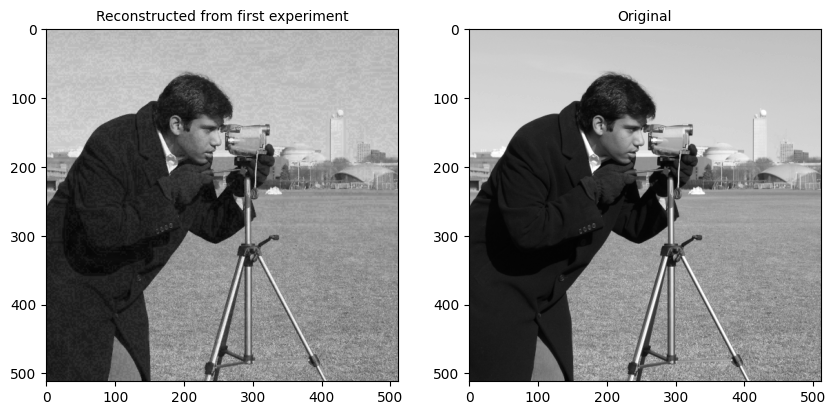

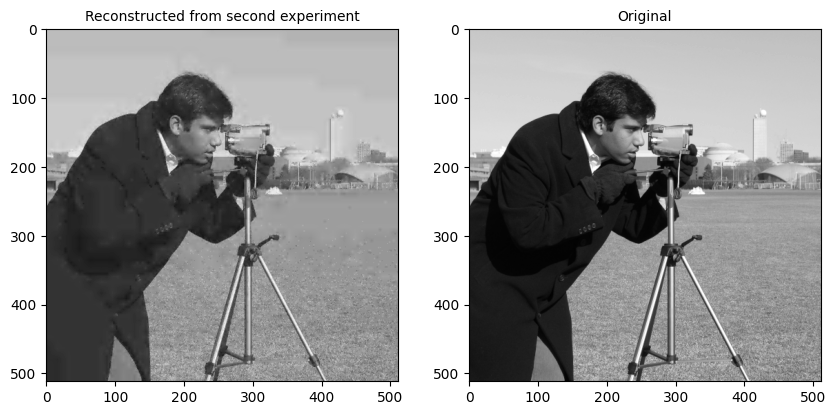

In [ ]:
Camera_decoded=showExperimentsDecoded(Camera,Camera_gray_lap_quant_first,Camera_gray_lap_quant_second,0.57,'gray')


Παρατηρούμε τα εξής:

Στο πρώτο πείραμα, έχουμε ανακατασκευασμένες εικόνες με αρκετά καλή ποιότητα σε σχέση με την αρχική. Οι ακμές είναι εμφανείς. Στην ανακατασκευή παρατηρείται μια σχετική υποβάθμιση στο χρώμα.
Στο δεύτερο πείραμα,  το οπτικό αποτέλεσμα της ανακατασκευής είναι χαμηλότερο. Οι ακμές και γενικά η εικόνα εμφανίζεται πιο θολή.